In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import numpy as np
import pandas as pd
from collections import namedtuple, defaultdict

In [2]:
bnt = namedtuple("bnt", "tmat early_cost late_cost norm_diff converged time")
stn = namedtuple("sim",
                 "sim_info "
                 "ancestor_info "
                 "rna_arrays "
                 "true_coupling "
                 "true_distances "
                 "fitted_tree_distances_late "
                 "hamming_distances_late "
                 "early_time_rna_cost "
                 "late_time_rna_cost")

In [3]:
def plot(res, suptitle="", figsize=(12, 3), dpi=180, **kwargs):
    vals = {
        "early_cost": defaultdict(defaultdict),
        "late_cost": defaultdict(defaultdict),
        "norm_diff": defaultdict(defaultdict),
        "time": defaultdict(defaultdict),
    }
    
    for alpha, vs in res.items():
        for epsilon, bench in vs.items():
            for attr, container in vals.items():
                container[alpha][-1 if epsilon is None else epsilon] = getattr(res[alpha][epsilon], attr, np.nan)
                
    fig, axes = plt.subplots(1, 4, tight_layout=True, dpi=dpi, figsize=figsize)
    fig.suptitle(flow_type)
    axes = np.ravel([axes])
    
    for ax, (attr, val) in zip(axes, vals.items()):
        print("Plotting:", attr)
        data = pd.DataFrame(val).sort_index()
        data.index = data.index.values.round(4)
        data.index = ["None" if i == -1 else str(i) for i in data.index]
        data.columns = data.columns.values.round(3)
        sns.heatmap(data, ax=ax, annot=True, fmt='.4g', cmap='viridis', **kwargs)
        ax.set_title(attr)
        ax.set_xlabel("alpha")
        ax.set_ylabel("epsilon")
        
    if suptitle:
        fig.savefig(f"{suptitle}.pdf")

In [4]:
pretty_suptitle = {
    '': '',
    '30': ', genes=30',
    'alphabet': ', alphabet=600',
    'mr': ', mutation_rate=0.16',
    'bcl': ', barcode_length=45',
    'bm': ', back_kmutations=True',
    'all': ', all',
}

In [5]:
!mkdir figures -p

Loading: bifurcation.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_30.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_alphabet.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_mr.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_bcl.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_bm.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: bifurcation_all.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: convergent.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: convergent_30.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: convergent_alphabet.pickle
P

<ipython-input-3-c83b35a92ad9>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1, 4, tight_layout=True, dpi=dpi, figsize=figsize)


Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: mismatched_clusters_alphabet.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: mismatched_clusters_mr.pickle
Unable to plot. Reason: [Errno 2] No such file or directory: 'mismatched_clusters_mr.pickle'
Loading: mismatched_clusters_bcl.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: mismatched_clusters_bm.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time
Loading: mismatched_clusters_all.pickle
Plotting: early_cost
Plotting: late_cost
Plotting: norm_diff
Plotting: time


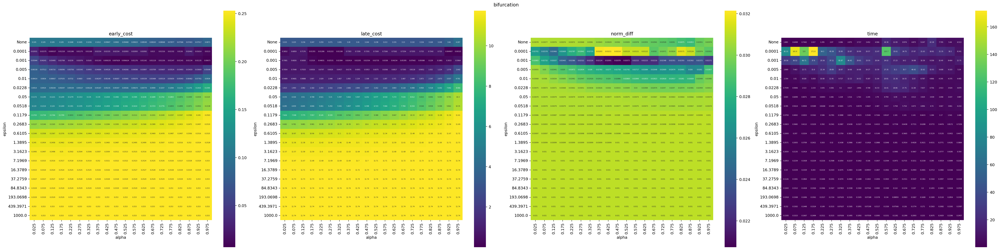

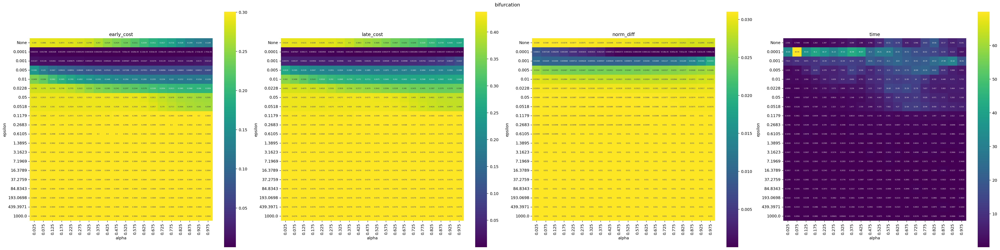

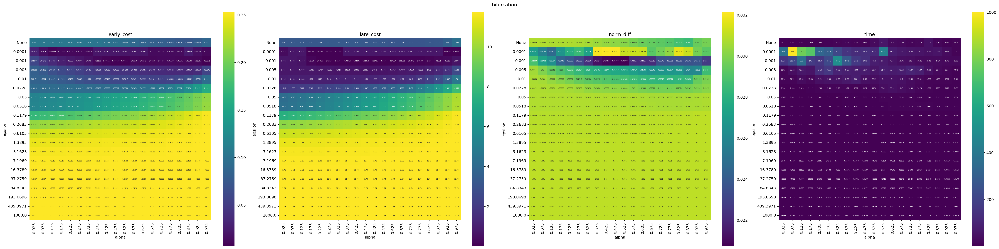

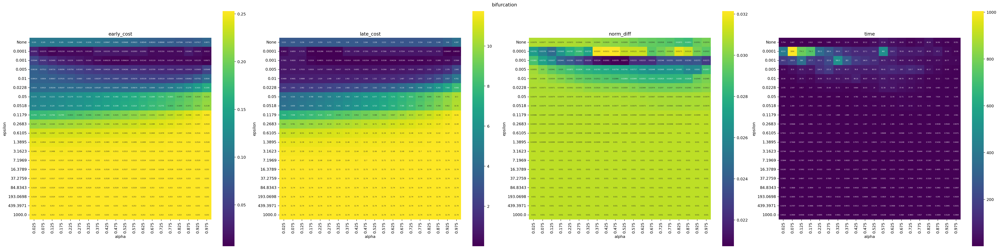

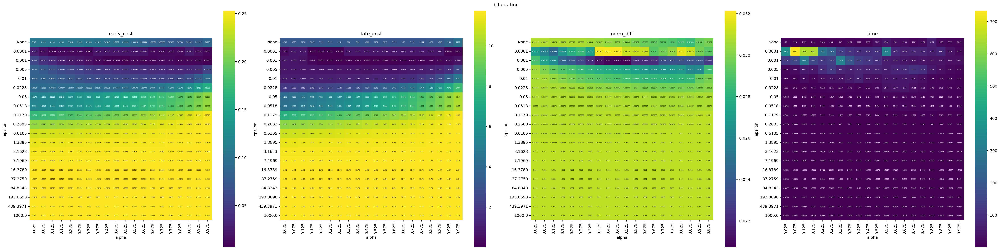

...

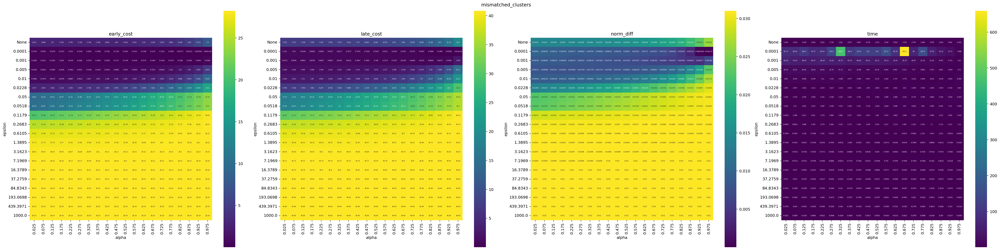

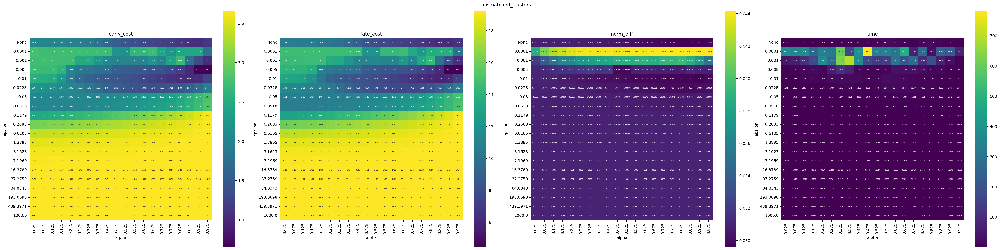

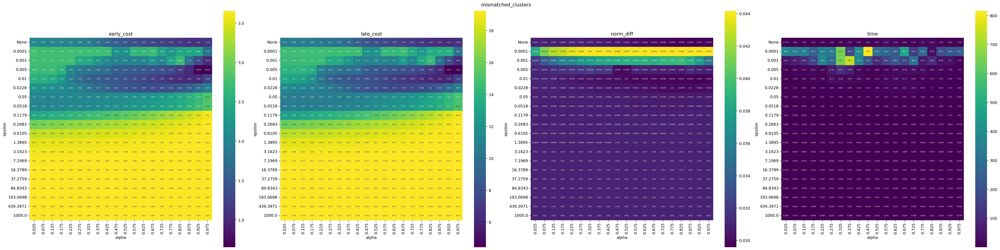

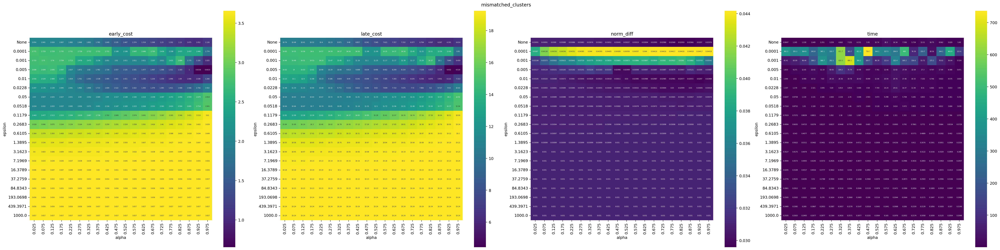

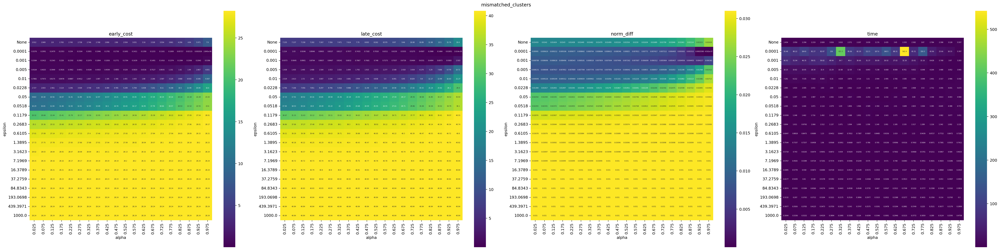

In [7]:
for flow_type in ["bifurcation", "convergent", "partial_convergent", "mismatched_clusters"]:
    for key, val in pretty_suptitle.items():
        if key:
            fname = f"{flow_type}_{key}.pickle"
        else:
            fname = f"{flow_type}.pickle"
        print("Loading:", fname)
        try:
            with open(fname, "rb") as fin:
                res = pickle.load(fin)
            d = plot(res, figsize=(36, 9), annot_kws={"fontsize": 4},
                     square=True, suptitle=f"figures/{flow_type}{val}")
        except Exception as e:
            # TODO(michalk8): regenerate mutation rate files
            print("Unable to plot. Reason:", e)